# Imports

In [1]:
import os
from matplotlib import pyplot as plt
import urllib.request
import requests
import json
import tensorflow as tf
import numpy as np
from keras import layers
import shutil
from keras.applications import VGG19

2026-01-04 18:40:31.147798: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


# Preparing data
## crating directories
this cell checking is the directories exists and if not it's creating them

In [2]:
if not (os.path.exists('./thumbnails')):
    os.mkdir('./thumbnails')
if not (os.path.exists("./thumbnails/malignant")):
    os.mkdir("./thumbnails/malignant")
if not (os.path.exists('./thumbnails/benign')):
    os.mkdir('./thumbnails/benign')

## Getting images from ISIC API
this cell gets first response from api which contain 100 images convering it to dictonary and printing it (link to API docs: https://api.isic-archive.com/api/docs/swagger/)

In [3]:
api_response = requests.get(
    'https://api.isic-archive.com/api/v2/images/?cursor=cD0yMDIyLTExLTE0KzIyJTNBMTMlM0EwMi4xMTM2NjElMkIwMCUzQTAw')
data = json.loads(api_response.text)
data

{'results': [{'isic_id': 'ISIC_9262713',
   'copyright_license': 'CC-0',
   'attribution': 'Memorial Sloan Kettering Cancer Center',
   'files': {'full': {'url': 'https://content.isic-archive.com/afd59de2-3996-42a2-a02b-40d50c981dae/45750d8e-f2e1-4e2f-a90e-a01653b279b0.jpg?Expires=1714003200&Signature=n8jNOO~V-yWuuGpTonE1D4r1U6f6MtCFznoaZSm2pR8vKvjMEttPQaS1uXEAO0pKVwzGVQLEIlLGYGL6nRnZ2SV3zm8TJ95rf-qdnvU4lQWER3hNQJL6KhyBmKFRUEH0Gvb~dkY~0wWVZ2N9PiJchvtQ92ItCISRXsuOn7vW3SJRSc2O0K0~sZVU1STJFq24BXVFmSn9ky2bloSd5TFctq8JC0hNcignfjz-RSIBJWuXA8gxiM3QS3lRvocovMJcIiJ7ahWjTkNzs52SqnwV3e-1pxONR5NRh2cFI5J-grrryb~htyOw9~Od7tsHK8YyrRiJhzqtKpByq-ZpKxaLgg__&Key-Pair-Id=K1C8I6SNK7JVJ8',
     'size': 571178},
    'thumbnail_256': {'url': 'https://content.isic-archive.com/982c4570-afc0-4ccf-bc35-51eb73f0fc1f/thumbnail_256.jpg?Expires=1714003200&Signature=LwJm5UCMwJhpnZRU678gNi7xV6UJ6xkZ52UqIpTKj0MOIzqLeiS9-MqbU2vqVnCy9W-UrFHkbQE5tuiF2Lp15vn3K4mVRqI7AsBsnDot3Wea4tuYQ9s1FLYCQlY7EG3TvRnXeQkCNScLrUF-4hBLDZMIjX

this cell defines a function which gets a single api result record then checking a type of change (malicious/notmalicious) and saving it in correct folder

In [4]:
def get_thumbnail_image_from_api(api_response_result: list, more_benign: bool) -> None:
    '''returns array representation of image
     from api record provided in argument'''
    try:
        if api_response_result['metadata']['clinical']['benign_malignant'] == 'benign' and more_benign:
            if not (os.path.exists(f"thumbnails/benign/{api_response_result['isic_id']}.jpg")):
                f = open(f"thumbnails/benign/{api_response_result['isic_id']}.jpg", 'wb')
                url = urllib.request.urlopen(api_response_result['files']['thumbnail_256']['url'])
                f.write(url.read())
                print(f"{api_response_result['isic_id']} classified as {api_response_result['metadata']['clinical']['benign_malignant']} saved sucesfuly")
            else:
                print("file already exists")
        elif api_response_result['metadata']['clinical']['benign_malignant'] == 'malignant':
            if not (os.path.exists(f"thumbnails/malignant/{api_response_result['isic_id']}.jpg")):
                f = open(f"thumbnails/malignant/{api_response_result['isic_id']}.jpg", 'wb')
                url = urllib.request.urlopen(api_response_result['files']['thumbnail_256']['url'])
                f.write(url.read())
                print(f"{api_response_result['isic_id']} saved classified as {api_response_result['metadata']['clinical']['benign_malignant']} sucesfuly")
            else:
                print("file already exists")
        elif 'indeterminate' in api_response_result['metadata']['clinical']['benign_malignant']:
            print(f"image classified as {api_response_result['metadata']['clinical']['benign_malignant']} ignored")
        else: 
            print("benigns saved")
    except:
        pass

this cell iterates over all 71670 images and saves it in two directiories *(malicious/notmalicious)* using **get_image_array_from_api** function

Do not run if the date is already downloaded. It takes significant amount of time to download.

In [41]:
# repeats = int(round(data['count'], -2) / 100) 
# benign = os.listdir('./thumbnails/benign')
# for i in range(repeats):#saving dataset
#     print(len(benign), len(benign) < 6100)
#     for image_data in data['results']:
#         get_thumbnail_image_from_api(image_data, len(benign) < 6100)
#     print(f"{(i + 1) * 100} images saved {(717 - i + 1) * 100} left")
#     api_response = requests.get(data['next'])
#     data = json.loads(api_response.text)
#     benign = os.listdir('./thumbnails/benign')
    

In [2]:
print(len(os.listdir('./thumbnails/benign')), len(os.listdir('./thumbnails/malignant')))

5557 5481


# TODO
- trainig i test data i np 90% do traningu a 10% do testu
- sprawdzić wielkość zdjęć

In [43]:
if not (os.path.exists('./test')):
    os.mkdir('./test')
if not (os.path.exists("./test/benign")):
    os.mkdir("./test/benign")
if not (os.path.exists('./test/malignant')):
    os.mkdir('./test/malignant')

This code is used to reduce the number of files by 90% to train the model faster when trying different approaches.

In [44]:
# for dir in os.listdir('./thumbnails'):
#     tenPrecent = len(os.listdir(f'./thumbnails/{dir}')) / 10
#     allFiles = os.listdir(f'./thumbnails/{dir}')
#     filesToTransfer = [allFiles[x] for x in range(int(tenPrecent))]
#     for fileToTransfer in filesToTransfer:
#         shutil.move(os.path.join(f'./thumbnails/{dir}/{fileToTransfer}'), f'./test/{dir}')

This function standardizes images to 256x256 resolution and saves the processed files to disk.

In [45]:
def resize_the_image(image_to_resize, save_path:str, show_img:bool=False)->tf.shape:
    resized_image = tf.image.resize(image_to_resize, (256, 256))
    tf.keras.utils.save_img(save_path ,resized_image)
    if show_img:
        plt.imshow(resized_image)
        plt.title(f"{save_path} after resize")
    return resized_image.shape

This function loads images and scales pixel values to a 0-1 range to prepare them for the model.

In [46]:
def image_to_array(img_path):
    image = plt.imread(img_path)
    array = tf.keras.utils.img_to_array(image, dtype=np.float32)
    array = tf.math.divide(array, 255)
    return array

In [6]:
len(os.listdir('./thumbnails/benign')), len(os.listdir('./thumbnails/malignant'))

(5557, 5481)

This loop scans the dataset and automatically resizes any images that do not match the required dimensions.

In [48]:
# for dir in os.listdir('./thumbnails'): #changing size
#     for image in os.listdir(f"./thumbnails/{dir}"):
#         img_array = image_to_array(f"./thumbnails/{dir}/{image}")
#         if len(img_array) != 256 or len(img_array[0]) != 256:
#             print(resize_the_image(img_array, f"./thumbnails/{dir}/{image}"))
            

# Model Preparation and training
### (for testing load trained model) from the end of notebook

In [2]:
# crate a VGG19 model
vgg19 = VGG19(
    weights ='imagenet',
    include_top=False,
    input_shape=(256, 256, 3)
)

#setting trainable to True for layers except input layer
#iterating over model layers
for layer in vgg19.layers:
    layer.trainable = False


#showing a summary for VGG19 model
vgg19.summary()

Model: "vgg19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type) ┃ Output Shape ┃ Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer ( InputLayer ) │ ( None , 256 , 256 , 3 ) │ 0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 ( Conv2D ) │ ( None , 256 , 256 , 64 ) │ 1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 ( Conv2D ) │ ( None , 256 , 256 , 64 ) │ 36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool ( MaxPooling2D ) │ ( None , 128 , 128 , 64 ) │ 0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 ( Conv2D ) │ ( None , 128 , 128 , 128 ) │ 73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 ( Conv2D ) │ ( None , 128 , 128 , 128 ) │ 147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool ( MaxPooling2D ) │ ( None , 64 , 64 , 128 ) │ 0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 ( Conv2D ) │ ( None , 64 , 64 , 256 ) │ 295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 ( Conv2D ) │ ( None , 64 , 64 , 256 ) │ 590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 ( Conv2D ) │ ( None , 64 , 64 , 256 ) │ 590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 ( Conv2D ) │ ( None , 64 , 64 , 256 ) │ 590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool ( MaxPooling2D ) │ ( None , 32 , 32 , 256 ) │ 0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 ( Conv2D ) │ ( None , 32 , 32 , 512 ) │ 1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 ( Conv2D ) │ ( None , 32 , 32 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 ( Conv2D ) │ ( None , 32 , 32 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 ( Conv2D ) │ ( None , 32 , 32 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool ( MaxPooling2D ) │ ( None , 16 , 16 , 512 ) │ 0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 ( Conv2D ) │ ( None , 16 , 16 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 ( Conv2D ) │ ( None , 16 , 16 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 ( Conv2D ) │ ( None , 16 , 16 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 ( Conv2D ) │ ( None , 16 , 16 , 512 ) │ 2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool ( MaxPooling2D ) │ ( None , 8 , 8 , 512 ) │ 0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

Total params: 20,024,384 (76.39 MB)

Trainable params: 0 (0.00 B)

Non-trainable params: 20,024,384 (76.39 MB)

In [3]:
batch_size = 32

Preparing data generators for training

In [5]:
datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True)

train_generator = datagen.flow_from_directory(
        '/data/notebook_files/thumbnails',
        target_size=(256, 256),
        batch_size=16,
        class_mode='categorical')

test_generator = datagen.flow_from_directory(
    '/data/notebook_files/test',
    target_size=(256, 256),
    batch_size=16,
    class_mode='categorical'
)

Found 11038 images belonging to 2 classes.
Found 1226 images belonging to 2 classes.


In [6]:
print(test_generator.__len__())

77


This code cell displays generated data

(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
(16, 256, 256, 3)
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14


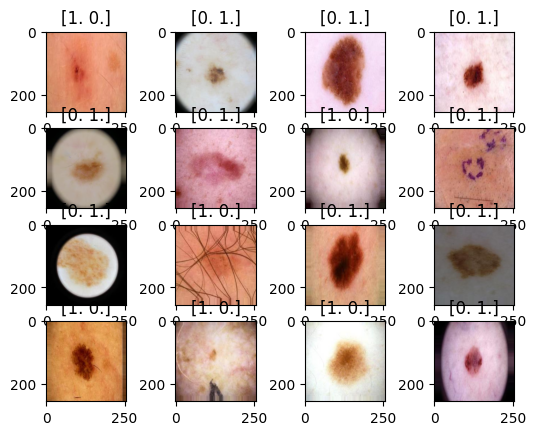

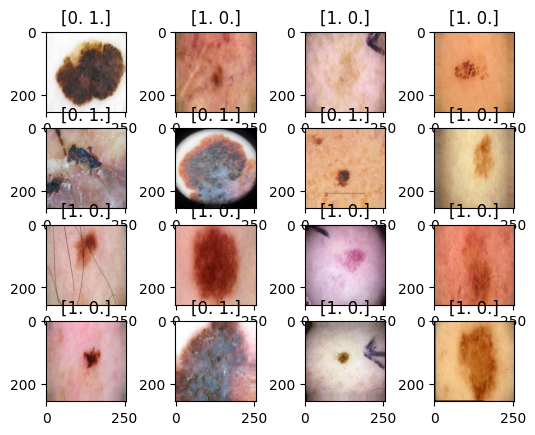

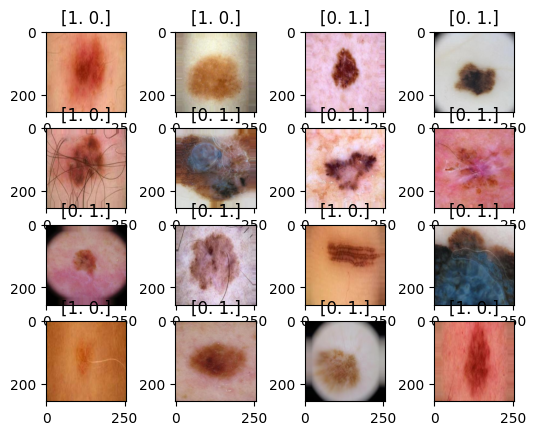

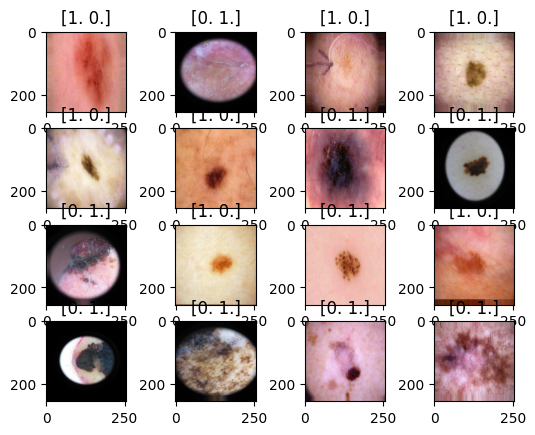

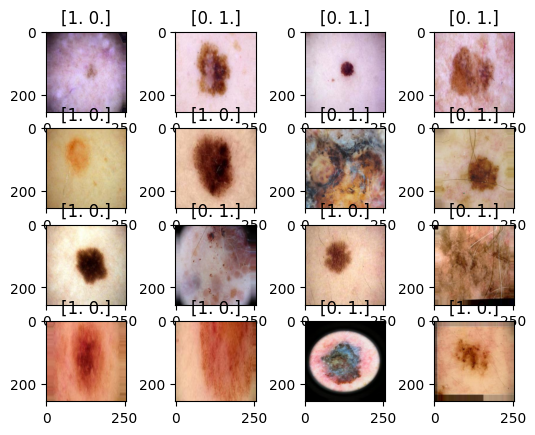

...

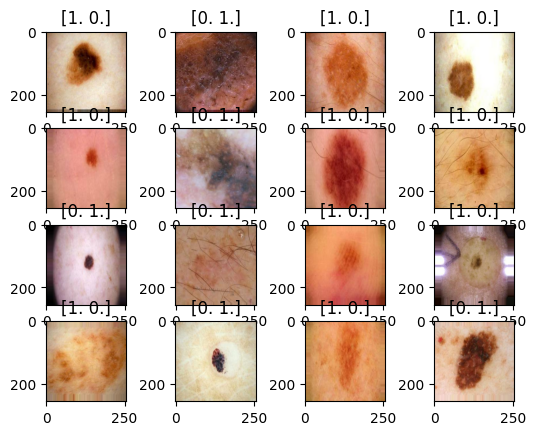

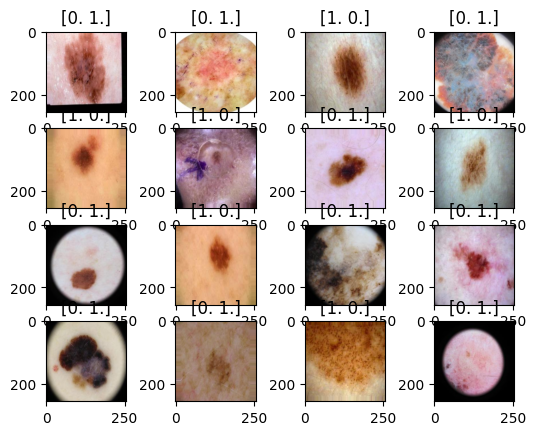

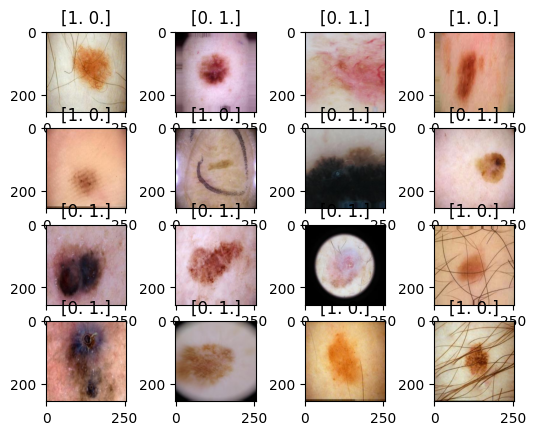

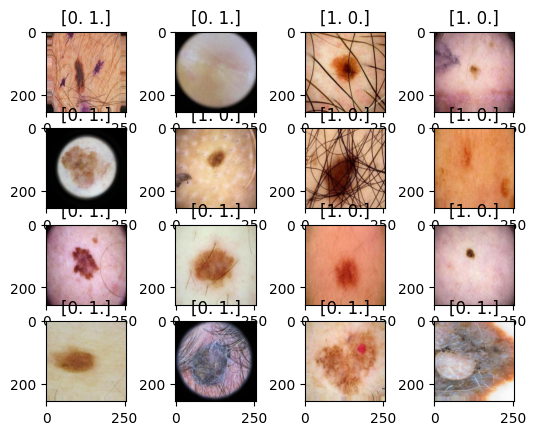

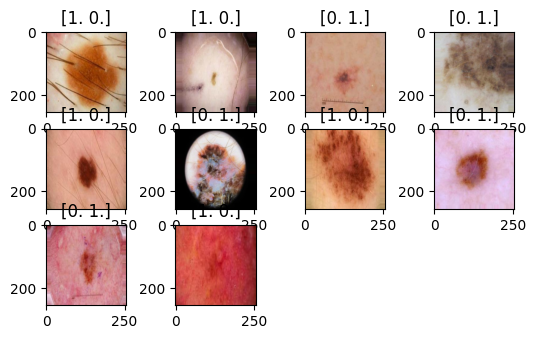

In [8]:
for _ in range(77):
    img, label = next(test_generator)
    print(img.shape)   #  (1,256,256,3)
    print(len(img)) 
    for index in range(0, len(img)):
        print(index)
        plt.subplot(4, 4, index+1)
        plt.title(label[index])
        plt.imshow(img[index])
    plt.show()

Defining model structure with VGG19 transfer learning

In [5]:
model = tf.keras.models.Sequential()
# model.add(layers.Conv2D(256, (5, 5), activation='relu', input_shape=(256, 256, 3)))
# model.add(layers.MaxPooling2D((2, 2)))
# model.add(layers.Conv2D(128, (5, 5), activation='relu'))
# model.add(layers.MaxPooling2D((2, 2)))
# model.add(layers.Conv2D(128, (5, 5), activation='relu'))
# model.add(layers.MaxPooling2D((2, 2)))
# model.add(layers.Conv2D(64, (3, 3), activation='relu'))
# model.add(layers.MaxPooling2D((2, 2)))
# model.add(layers.Conv2D(64, (3, 3), activation='relu'))
# model.add(layers.MaxPooling2D((2, 2)))
model.add(vgg19)
model.add(layers.Flatten())
model.add(layers.Dense(128, activation="relu"))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(2, activation="softmax"))

2026-01-04 18:41:44.343662: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 16777216 exceeds 10% of free system memory.
2026-01-04 18:41:44.377177: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 16777216 exceeds 10% of free system memory.


In [12]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 8, 8, 512)         20024384  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 128)               4194432   
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 2)                 258       
                                                                 
Total params: 24,219,074
Trainable params: 4,194,690
Non-trainable params: 20,024,384
_________________________________________________________________


# Model training 
### (at least 4GB RAM suggested)

In [13]:
#opt= tf.keras.optimizers.Adam(learning_rate=0.001)

#model.compile(optimizer='adam', loss=tf.keras.losses.BinaryCrossentropy(), metrics=['accuracy'])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss=tf.keras.losses.CategoricalCrossentropy(),
    metrics=['accuracy']
)

In [14]:
train_generated = train_generator
model.fit(train_generated, epochs=8, batch_size=batch_size)

Epoch 1/8
690/690 [==============================] - 491s 705ms/step - loss: 0.4612 - accuracy: 0.7856
Epoch 2/8
690/690 [==============================] - 348s 504ms/step - loss: 0.3681 - accuracy: 0.8479
Epoch 3/8
690/690 [==============================] - 321s 466ms/step - loss: 0.3396 - accuracy: 0.8609
Epoch 4/8
690/690 [==============================] - 318s 460ms/step - loss: 0.3184 - accuracy: 0.8675
Epoch 5/8
690/690 [==============================] - 336s 487ms/step - loss: 0.3072 - accuracy: 0.8769
Epoch 6/8
690/690 [==============================] - 328s 476ms/step - loss: 0.2921 - accuracy: 0.8849
Epoch 7/8
690/690 [==============================] - 323s 468ms/step - loss: 0.2873 - accuracy: 0.8868
Epoch 8/8
690/690 [==============================] - 518s 752ms/step - loss: 0.2761 - accuracy: 0.8925


Function to test if model works correctly. After providing image path, function will print model prediction.

(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 3s 3s/step
predict was True result is [0.0185764  0.98142356] model have discrepancy 0.9628471732139587


(1, 1, True, 0.9628472, array([0.0185764 , 0.98142356], dtype=float32))

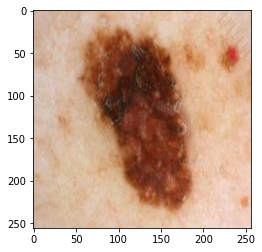

In [7]:
def predict_image(path:str):
    test = tf.keras.utils.load_img(path)
    test = tf.keras.utils.img_to_array(test)
    test = tf.image.resize(test, (256, 256))
    test /= 255
    test = np.expand_dims(test, axis=0) # add an extra dimension to create a batch of one image
    plt.imshow(test[0]) # plot the first image in the batch
    print(test.shape)
    print(train_generator.class_indices)
    result = model.predict(test)[0]
    if result[0] > result[1]:
        predict = 0
        discrepancy = result[0] - result[1]
    else:
        predict = 1
        discrepancy = result[1] - result[0]

    predicted_class = ['benign', 'malignant'][predict]
    score = predicted_class in path.split('/')
    label = 0 if "benign" in path.split('/') else 1
    print(f"predict was {score} result is {result} model have discrepancy {discrepancy}")
    return predict, label, score, discrepancy, result


predict_image('/data/notebook_files/test/malignant/ISIC_0000156.jpg')

In [60]:
# test_images = tf.keras.utils.image_dataset_from_directory('./test', labels='inferred', label_mode='categorical')

In [16]:
test_images = tf.keras.utils.image_dataset_from_directory('./test', labels='inferred', label_mode='categorical')

Found 1226 files belonging to 2 classes.


This cell thest the model evaluation on test dataset and also saves the images with model's highest certainity and correct prediction.

(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 0s 25ms/step
predict was True result is [0.88378686 0.11621314] model have discrepancy 0.7675737142562866
{'correct': 1, 'incorrect': 0}
(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 0s 24ms/step
predict was True result is [0.9880484  0.01195162] model have discrepancy 0.9760967493057251
{'correct': 2, 'incorrect': 0}
(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 0s 31ms/step
predict was True result is [0.92987376 0.07012621] model have discrepancy 0.8597475290298462
{'correct': 3, 'incorrect': 0}
(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 0s 25ms/step
predict was True result is [0.9055078  0.09449215] model have discrepancy 0.8110156655311584
{'correct': 4, 'incorrect': 0}
(1, 256, 256, 3)
{'benign': 0, 'malignant': 1}
1/1 [==============================] - 0s 26ms/step
predict w

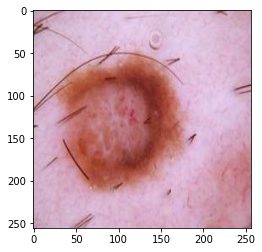

In [16]:
score = {'correct': 0, 'incorrect': 0}
label = []
predict = []
for dir in os.listdir('/data/notebook_files/test'):
    for file in os.listdir(f'/data/notebook_files/test/{dir}'):
        predicted_class, class_label, result, discrepancy, _ = predict_image(f'/data/notebook_files/test/{dir}/{file}')
        if result:
            score['correct']+=1
        else:
            score['incorrect']+=1
        
        if discrepancy > 0.9 and result:
            shutil.copy(f'/data/notebook_files/test/{dir}/{file}', f"/data/notebook_files/best_photos/{dir}/{file}")
        print(score)
        label.append(class_label)
        predict.append(predicted_class)

matrix = tf.math.confusion_matrix(label, predict)
    
    
    

Confusion matrix for evaluation above.

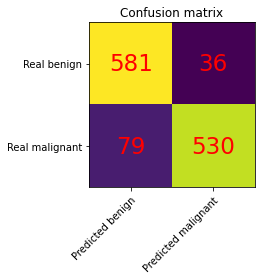

In [18]:
fig, ax = plt.subplots()
im = ax.imshow(matrix)
y_labels = ["Real benign", "Real malignant"]
x_labels = ["Predicted benign", "Predicted malignant"]

# Show all ticks and label them with the respective list entries
ax.set_xticks(np.arange(len(x_labels)), labels=x_labels)
ax.set_yticks(np.arange(len(y_labels)), labels=y_labels)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(y_labels)):
    for j in range(len(x_labels)):
        text = ax.text(j, i, int(matrix[i, j]),
                       ha="center", va="center", color="r", size=23)

ax.set_title("Confusion matrix")
fig.tight_layout()
plt.show()

built-in tensorflow's evalutation method. Doesn't save best results

In [26]:
model.evaluate(test_generator)

77/77 [==============================] - 21s 275ms/step - loss: 0.2341 - accuracy: 0.9201


[0.23411783576011658, 0.9200652241706848]

# Further model training

In [22]:
for layer in vgg19.layers:
    layer.trainable = True

vgg19.layers[0].trainable = False

vgg19.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0     

In [23]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 8, 8, 512)         20024384  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 128)               4194432   
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 2)                 258       
                                                                 
Total params: 24,219,074
Trainable params: 24,219,074
Non-trainable params: 0
_________________________________________________________________


In [24]:
model.fit(train_generator, epochs=8, batch_size=batch_size)

Epoch 1/8
690/690 [==============================] - 299s 433ms/step - loss: 0.2742 - accuracy: 0.8935
Epoch 2/8
690/690 [==============================] - 331s 479ms/step - loss: 0.2664 - accuracy: 0.8975
Epoch 3/8
690/690 [==============================] - 325s 470ms/step - loss: 0.2603 - accuracy: 0.9004
Epoch 4/8
690/690 [==============================] - 339s 492ms/step - loss: 0.2551 - accuracy: 0.8986
Epoch 5/8
690/690 [==============================] - 321s 466ms/step - loss: 0.2538 - accuracy: 0.9003
Epoch 6/8
690/690 [==============================] - 304s 441ms/step - loss: 0.2443 - accuracy: 0.9036
Epoch 7/8
690/690 [==============================] - 301s 435ms/step - loss: 0.2443 - accuracy: 0.9049
Epoch 8/8
690/690 [==============================] - 299s 434ms/step - loss: 0.2411 - accuracy: 0.9067


Saving trained model

In [27]:
path = './models/vgg19_92%_secound_phase'
if not os.path.exists(path):
    model.save(path)
else:
    print("Model already exist, delete exising model or change saving path")

INFO:tensorflow:Assets written to: ./models/vgg19_92%_secound_phase/assets


INFO:tensorflow:Assets written to: ./models/vgg19_92%_secound_phase/assets


# Loading saved model
If you want to train or evaluate one of the trained models, you can load it here, and it will be then available in the whole notebook under `model` variable.

In [3]:
model = tf.keras.models.load_model('./models/vgg19_92%_secound_phase')

In [34]:
# loaded_model.summary()

In [35]:
# loaded_model.evaluate(test)